<h2> <span style="color: Red;"> UniMi | SL | Supervised Learning | Amr Rashad FIFA 23 Player Attributes dataset </span> </h2>

## <span style="color: LightBlue;"> 0. Outline </span>

- The Curse of Dimensionality is a serious problem, and our dataset suffers from high-dimensionality. To avoid such problem, I will be using Principal Component Analysis before clustering, in order to reduce number of dimensions, but also to reduce unnecessary noise of data. This will possibly improve the clustering performance for the following methods that are going to be used: 
    - K-means clustering
    - Hierarchical clustering

## <span style="color: IndianRed;"> 1. Loading & Preparing The Dataset: </span>

### <span style="color: LightSalmon;"> *1.1 Load Required Libraries:* </span>

In [1]:
library(MASS)
library(ggpubr)
library(olsrr)
library(dplyr)
library(purrr)
library (DescTools)
library(gplots)
library(car)
library(Hmisc)
library(PerformanceAnalytics)
library(olsrr)
library(ISLR)
library(rpart)
library(rpart.plot)
library(party)
library("partykit")
library(caTools)
library(caret)
library(randomForest)
library(ranger)
library(corrplot)
library(tidyverse)
library("magrittr")
library(gridExtra)
library(cowplot)
library(pROC)
library(ggcorrplot)
library(tree)
library(leaps)
library(class)
library("pROC")
library(lares)
library(rgl)
library(cluster)
library(plotly)
library(dendextend)

Warning message:
"package 'ggpubr' was built under R version 4.1.3"
Loading required package: ggplot2

Warning message:
"package 'ggplot2' was built under R version 4.1.3"
Warning message:
"package 'olsrr' was built under R version 4.1.3"

Attaching package: 'olsrr'


The following object is masked from 'package:MASS':

    cement


The following object is masked from 'package:datasets':

    rivers



Attaching package: 'dplyr'


The following object is masked from 'package:MASS':

    select


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union


Warning message:
"package 'DescTools' was built under R version 4.1.3"
Warning message:
"package 'gplots' was built under R version 4.1.3"
Registered S3 method overwritten by 'gplots':
  method         from     
  reorder.factor DescTools


Attaching package: 'gplots'


The following object is masked from 'package:DescTools':


### <span style="color: LightSalmon;"> *1.2 Load Dataset:* </span>

In [2]:
FPA <- read.csv(file='FIFA23_Player_Attributes.csv', stringsAsFactors=TRUE)

In [3]:
str(FPA)

'data.frame':	18539 obs. of  44 variables:
 $ ï..Full.Name          : Factor w/ 18337 levels "A. Zervandro Chiamuloira Paes",..: 10631 9714 15025 9883 10193 12834 16802 11381 2737 17591 ...
 $ Best.Position         : Factor w/ 15 levels "CAM","CB","CDM",..: 1 4 15 5 15 13 6 6 15 2 ...
 $ Weak.Foot.Rating      : int  4 4 4 5 4 3 3 4 4 3 ...
 $ Skill.Moves           : int  4 4 4 4 5 4 1 1 5 2 ...
 $ Pace.Total            : int  81 80 75 74 97 90 84 87 81 81 ...
 $ Shooting.Total        : int  89 88 91 88 89 89 89 88 92 60 ...
 $ Passing.Total         : int  90 83 79 93 80 82 75 91 78 71 ...
 $ Dribbling.Total       : int  94 87 86 87 92 90 90 88 85 72 ...
 $ Defending.Total       : int  34 39 44 64 36 45 46 56 34 91 ...
 $ Physicality.Total     : int  64 78 83 77 76 75 89 91 75 86 ...
 $ Crossing              : int  84 75 71 94 78 80 14 15 80 53 ...
 $ Finishing             : int  90 92 94 85 93 93 14 13 93 52 ...
 $ Heading.Accuracy      : int  70 90 91 55 72 59 13 25 90 87 ...
 $ Short

In [4]:
head(FPA)

,ï..Full.Name,Best.Position,Weak.Foot.Rating,Skill.Moves,Pace.Total,Shooting.Total,Passing.Total,Dribbling.Total,Defending.Total,Physicality.Total,...,Penalties,Composure,Marking,Standing.Tackle,Sliding.Tackle,Goalkeeper.Diving,Goalkeeper.Handling,GoalkeeperKicking,Goalkeeper.Positioning,Goalkeeper.Reflexes
,<fct>,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,Lionel Messi,CAM,4,4,81,89,90,94,34,64,...,75,96,20,35,24,6,11,15,14,8
2,Karim Benzema,CF,4,4,80,88,83,87,39,78,...,84,90,43,24,18,13,11,5,5,7
3,Robert Lewandowski,ST,4,4,75,91,79,86,44,83,...,90,88,35,42,19,15,6,12,8,10
4,Kevin De Bruyne,CM,5,4,74,88,93,87,64,77,...,83,89,68,65,53,15,13,5,10,13
5,Kylian MbappÃƒÂ©,ST,4,5,97,89,80,92,36,76,...,80,88,26,34,32,13,5,7,11,6
6,Mohamed Salah,RW,3,4,90,89,82,90,45,75,...,86,92,38,43,41,14,14,9,11,14


In [5]:
FPA["Player"] <- NA
FPA <- FPA %>% relocate(Player, .before = ï..Full.Name)

In [6]:
for(i in 1:nrow(FPA)){
    FPA$Player[i] = i 
}
FPA <- FPA[-2]
head(FPA)

,Player,Best.Position,Weak.Foot.Rating,Skill.Moves,Pace.Total,Shooting.Total,Passing.Total,Dribbling.Total,Defending.Total,Physicality.Total,...,Penalties,Composure,Marking,Standing.Tackle,Sliding.Tackle,Goalkeeper.Diving,Goalkeeper.Handling,GoalkeeperKicking,Goalkeeper.Positioning,Goalkeeper.Reflexes
,<int>,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,CAM,4,4,81,89,90,94,34,64,...,75,96,20,35,24,6,11,15,14,8
2,2,CF,4,4,80,88,83,87,39,78,...,84,90,43,24,18,13,11,5,5,7
3,3,ST,4,4,75,91,79,86,44,83,...,90,88,35,42,19,15,6,12,8,10
4,4,CM,5,4,74,88,93,87,64,77,...,83,89,68,65,53,15,13,5,10,13
5,5,ST,4,5,97,89,80,92,36,76,...,80,88,26,34,32,13,5,7,11,6
6,6,RW,3,4,90,89,82,90,45,75,...,86,92,38,43,41,14,14,9,11,14


### <span style="color: LightSalmon;"> *1.3 Data Preparation:* </span>

In [7]:
FPA <- data.frame(FPA)

In [8]:
#checking if there exist na values
apply(FPA, 2, function(x) any(is.na(x)))

Player          Best.Position       Weak.Foot.Rating 
                 FALSE                  FALSE                  FALSE 
           Skill.Moves             Pace.Total         Shooting.Total 
                 FALSE                  FALSE                  FALSE 
         Passing.Total        Dribbling.Total        Defending.Total 
                 FALSE                  FALSE                  FALSE 
     Physicality.Total               Crossing              Finishing 
                 FALSE                  FALSE                  FALSE 
      Heading.Accuracy          Short.Passing                Volleys 
                 FALSE                  FALSE                  FALSE 
             Dribbling                  Curve      Freekick.Accuracy 
                 FALSE                  FALSE                  FALSE 
           LongPassing            BallControl           Acceleration 
                 FALSE                  FALSE                  FALSE 
          Sprint.Speed                Agility              Reactions 
                 FALSE                  FALSE                  FALSE 
               Balance             Shot.Power                Jumping 
                 FALSE                  FALSE                  FALSE 
               Stamina               Strength             Long.Shots 
                 FALSE                  FALSE                  FALSE 
            Aggression          Interceptions            Positioning 
                 FALSE                  FALSE                  FALSE 
                Vision              Penalties              Composure 
                 FALSE                  FALSE                  FALSE 
               Marking        Standing.Tackle         Sliding.Tackle 
                 FALSE                  FALSE                  FALSE 
     Goalkeeper.Diving    Goalkeeper.Handling      GoalkeeperKicking 
                 FALSE                  FALSE                  FALSE 
Goalkeeper.Positioning    Goalkeeper.Reflexes 
                 FALSE                  FALSE

In [9]:
head(FPA)

,Player,Best.Position,Weak.Foot.Rating,Skill.Moves,Pace.Total,Shooting.Total,Passing.Total,Dribbling.Total,Defending.Total,Physicality.Total,...,Penalties,Composure,Marking,Standing.Tackle,Sliding.Tackle,Goalkeeper.Diving,Goalkeeper.Handling,GoalkeeperKicking,Goalkeeper.Positioning,Goalkeeper.Reflexes
,<int>,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,CAM,4,4,81,89,90,94,34,64,...,75,96,20,35,24,6,11,15,14,8
2,2,CF,4,4,80,88,83,87,39,78,...,84,90,43,24,18,13,11,5,5,7
3,3,ST,4,4,75,91,79,86,44,83,...,90,88,35,42,19,15,6,12,8,10
4,4,CM,5,4,74,88,93,87,64,77,...,83,89,68,65,53,15,13,5,10,13
5,5,ST,4,5,97,89,80,92,36,76,...,80,88,26,34,32,13,5,7,11,6
6,6,RW,3,4,90,89,82,90,45,75,...,86,92,38,43,41,14,14,9,11,14


Other available 'return' options: "skimr", "numbers", "names", "distr"

Warning message in .font_global(font, quiet = FALSE):
"Font 'Arial Narrow' is not installed, has other name, or can't be found"


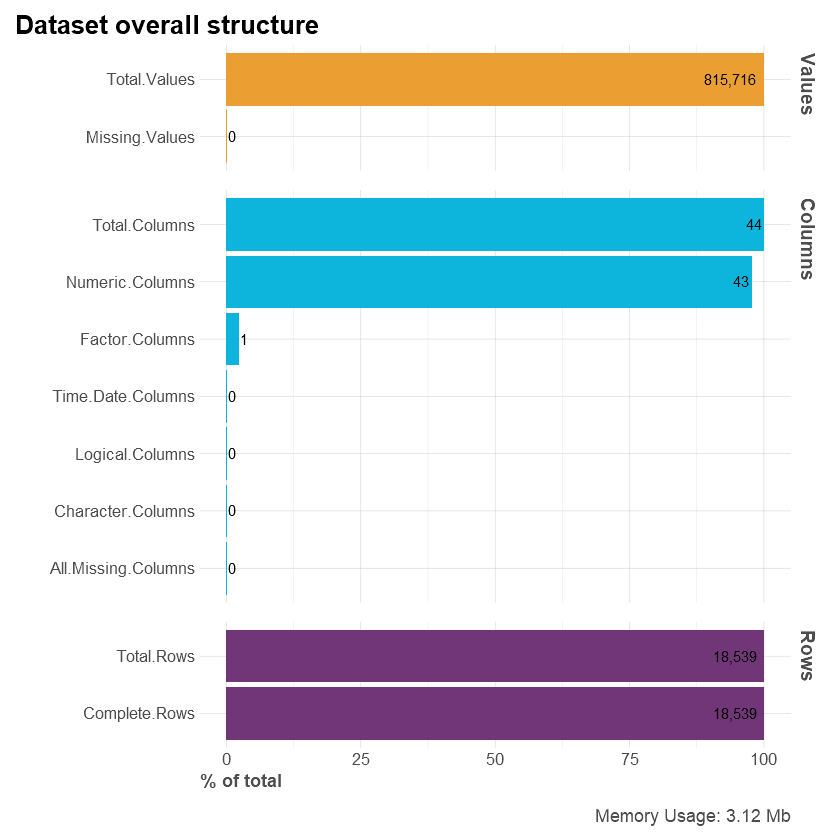

In [10]:
#Seeing the structure of the dataset
df_str(FPA, return = "plot")

## <span style="color: IndianRed;"> 2. Principal Component Analysis: </span>

In [11]:
row.names(FPA)<-FPA$Player
FPA<-FPA[,-1]
head(FPA)

,Best.Position,Weak.Foot.Rating,Skill.Moves,Pace.Total,Shooting.Total,Passing.Total,Dribbling.Total,Defending.Total,Physicality.Total,Crossing,...,Penalties,Composure,Marking,Standing.Tackle,Sliding.Tackle,Goalkeeper.Diving,Goalkeeper.Handling,GoalkeeperKicking,Goalkeeper.Positioning,Goalkeeper.Reflexes
,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,CAM,4,4,81,89,90,94,34,64,84,...,75,96,20,35,24,6,11,15,14,8
2,CF,4,4,80,88,83,87,39,78,75,...,84,90,43,24,18,13,11,5,5,7
3,ST,4,4,75,91,79,86,44,83,71,...,90,88,35,42,19,15,6,12,8,10
4,CM,5,4,74,88,93,87,64,77,94,...,83,89,68,65,53,15,13,5,10,13
5,ST,4,5,97,89,80,92,36,76,78,...,80,88,26,34,32,13,5,7,11,6
6,RW,3,4,90,89,82,90,45,75,80,...,86,92,38,43,41,14,14,9,11,14


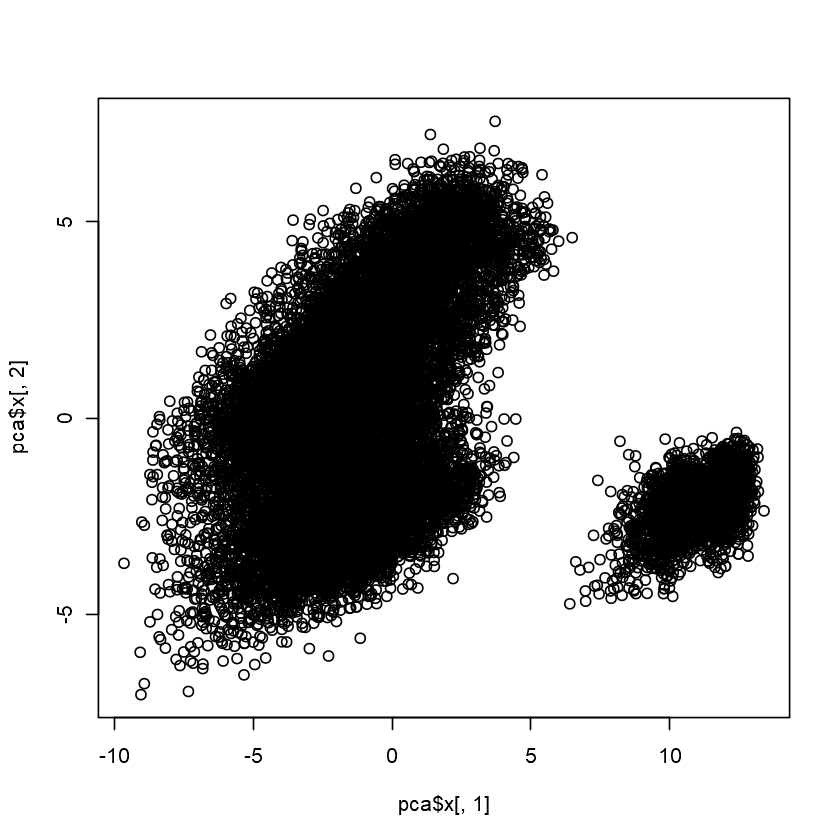

In [12]:
pca <- prcomp(FPA[-1], scale = TRUE)
plot(pca$x[,1], pca$x[,2])

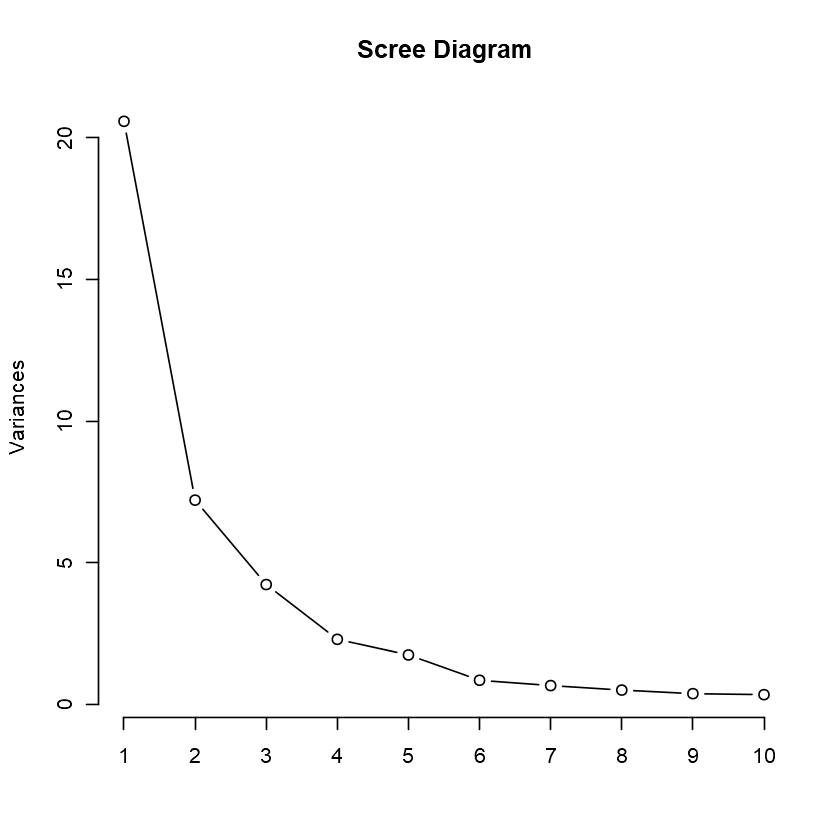

In [13]:
plot(pca, type = "lines", main = "Scree Diagram")

In [14]:
summary(pca)

Importance of components:
                          PC1    PC2    PC3     PC4     PC5     PC6    PC7
Standard deviation     4.5371 2.6848 2.0558 1.51426 1.31921 0.92019 0.8120
Proportion of Variance 0.4901 0.1716 0.1006 0.05459 0.04144 0.02016 0.0157
Cumulative Proportion  0.4901 0.6617 0.7624 0.81696 0.85840 0.87856 0.8943
                          PC8    PC9    PC10    PC11    PC12    PC13    PC14
Standard deviation     0.7071 0.6114 0.58185 0.57273 0.51982 0.49747 0.48883
Proportion of Variance 0.0119 0.0089 0.00806 0.00781 0.00643 0.00589 0.00569
Cumulative Proportion  0.9062 0.9151 0.92312 0.93093 0.93737 0.94326 0.94895
                          PC15    PC16    PC17    PC18    PC19    PC20    PC21
Standard deviation     0.45504 0.45256 0.43571 0.40781 0.39891 0.36713 0.35387
Proportion of Variance 0.00493 0.00488 0.00452 0.00396 0.00379 0.00321 0.00298
Cumulative Proportion  0.95388 0.95875 0.96327 0.96723 0.97102 0.97423 0.97721
                          PC22    PC23    PC24   P

It seems like the best number of principal components we can choose that would explain the maximal variation in the data with minimal loss of information is 3.

In [15]:
#Identifying the X, Y, Z coordinates of each data point (in our case it's the players), where each row represents a player
pca.data <- data.frame(rownames(pca$x), X = pca$x[,1], Y = pca$x[,2], Z = pca$x[,3])
head(pca.data)

,rownames.pca.x.,X,Y,Z
,<chr>,<dbl>,<dbl>,<dbl>
1,1,-9.058479,-7.048247,3.398240
2,2,-8.461731,-5.005057,3.893158
3,3,-8.549457,-4.359609,4.408863
4,4,-9.669586,-3.700620,5.484308
5,5,-9.085980,-5.968851,2.895785
6,6,-8.733202,-5.192656,3.570481


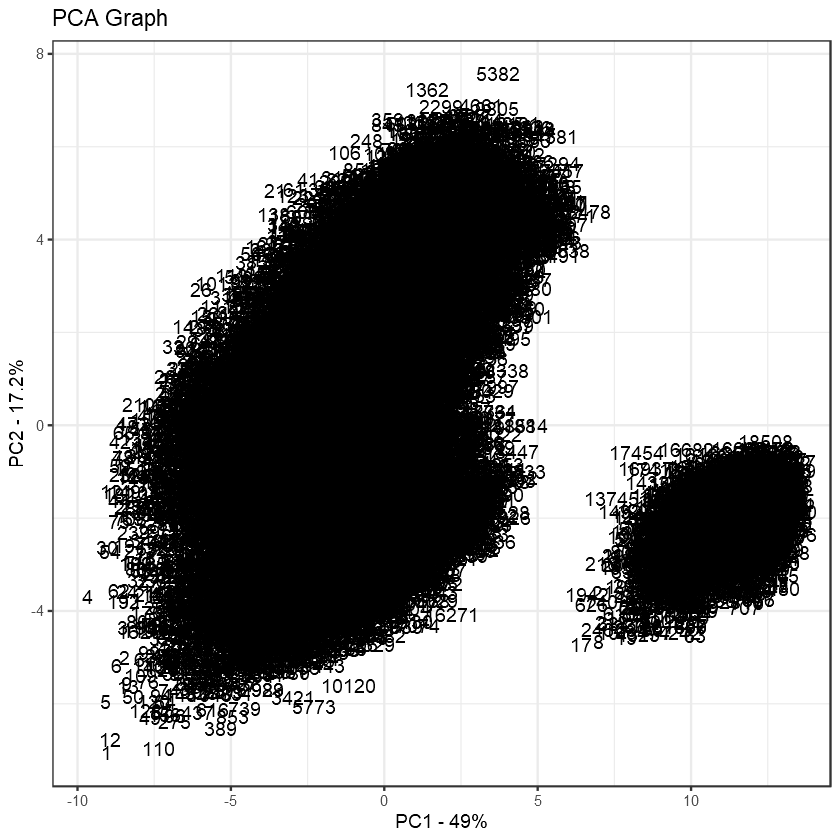

In [16]:
pca.var <- pca$sdev^2
pca.var.per <-round(pca.var/sum(pca.var)*100, 1)
ggplot(data = pca.data, aes(x = X, y = Y, label = rownames(pca$x)))+
geom_text()+
xlab(paste("PC1 - ", pca.var.per[1], "%", sep = ""))+
ylab(paste("PC2 - ", pca.var.per[2], "%", sep = ""))+
theme_bw()+
ggtitle("PCA Graph")

- The x-axis tells us what percentage of the variation in the original data that PC1 accounts for
- The y-axis tells us what percentage of the variation in the original data that PC2 accounts for

- Let's look at how to use the loading scores to determine which attributes have the largest effect on where players are plotted in the PCA plot
- Let's first look at the loading scores for PC1 since it accounts for 49% of the variation in the data

In [17]:
loading.scores <- pca$rotation[,1]
attribute.scores <- abs(loading.scores)
#sorting the magnitude of the loading scores from high to low
attribute.scores.ranked <- sort(attribute.scores, decreasing = TRUE)
#now we get the names of the top 10 attributes with the largest loading score magnitudes
top10.attributes <- names(attribute.scores.ranked[1:10])
top10.attributes

[1] "BallControl"       "Dribbling"         "Short.Passing"    
 [4] "Positioning"       "Crossing"          "Curve"            
 [7] "Long.Shots"        "LongPassing"       "Goalkeeper.Diving"
[10] "Freekick.Accuracy"

In [18]:
#We try to see which of the top 10 attributes have positive(resulting in pushing the datapoints to the right)/negative (resulting in pushing the datapoints to the left) loading scores
pca$rotation[top10.attributes, 1]

BallControl         Dribbling     Short.Passing       Positioning 
       -0.2123112        -0.2084408        -0.2036357        -0.1973638 
         Crossing             Curve        Long.Shots       LongPassing 
       -0.1948877        -0.1945457        -0.1913128        -0.1825612 
Goalkeeper.Diving Freekick.Accuracy 
        0.1821924        -0.1820400

- Let's now look at the loading scores for PC2 which accounts for 17.2% of the variation in the data

In [19]:
loading.scores <- pca$rotation[,2]
attribute.scores <- abs(loading.scores)
#sorting the magnitude of the loading scores from high to low
attribute.scores.ranked <- sort(attribute.scores, decreasing = TRUE)
#now we get the names of the top 10 attributes with the largest loading score magnitudes
top10.attributes <- names(attribute.scores.ranked[1:10])
top10.attributes

[1] "Shooting.Total"  "Sliding.Tackle"  "Defending.Total" "Standing.Tackle"
 [5] "Interceptions"   "Marking"         "Dribbling.Total" "Aggression"     
 [9] "Pace.Total"      "Passing.Total"

In [20]:
#We try to see which of the top 10 attributes have positive(resulting in pushing the datapoints to the right)/negative (resulting in pushing the datapoints to the left) loading scores
pca$rotation[top10.attributes, 2]

Shooting.Total  Sliding.Tackle Defending.Total Standing.Tackle   Interceptions 
     -0.3090246       0.2819032       0.2795372       0.2763714       0.2697522 
        Marking Dribbling.Total      Aggression      Pace.Total   Passing.Total 
      0.2695221      -0.2516757       0.1982359      -0.1765464      -0.1735039

- Finally, let's look at the loading scores for PC3 which accounts for 10.1% of the variation in the data

In [21]:
loading.scores <- pca$rotation[,3]
attribute.scores <- abs(loading.scores)
#sorting the magnitude of the loading scores from high to low
attribute.scores.ranked <- sort(attribute.scores, decreasing = TRUE)
#now we get the names of the top 10 attributes with the largest loading score magnitudes
top10.attributes <- names(attribute.scores.ranked[1:10])
top10.attributes

[1] "Reactions"              "Passing.Total"          "Physicality.Total"     
 [4] "Dribbling.Total"        "Strength"               "Goalkeeper.Positioning"
 [7] "Shooting.Total"         "Goalkeeper.Handling"    "Goalkeeper.Reflexes"   
[10] "GoalkeeperKicking"

In [22]:
#We try to see which of the top 10 attributes have positive(resulting in pushing the datapoints to the right)/negative (resulting in pushing the datapoints to the left) loading scores
pca$rotation[top10.attributes, 3]

Reactions          Passing.Total      Physicality.Total 
             0.3368348              0.3365774              0.3288816 
       Dribbling.Total               Strength Goalkeeper.Positioning 
             0.2402724              0.2161979              0.2084209 
        Shooting.Total    Goalkeeper.Handling    Goalkeeper.Reflexes 
             0.2073868              0.2071078              0.2062255 
     GoalkeeperKicking 
             0.2061730

Let's now draw a biplot to determine how exactly the players are distributed based on the loading scores of PC1 and PC2

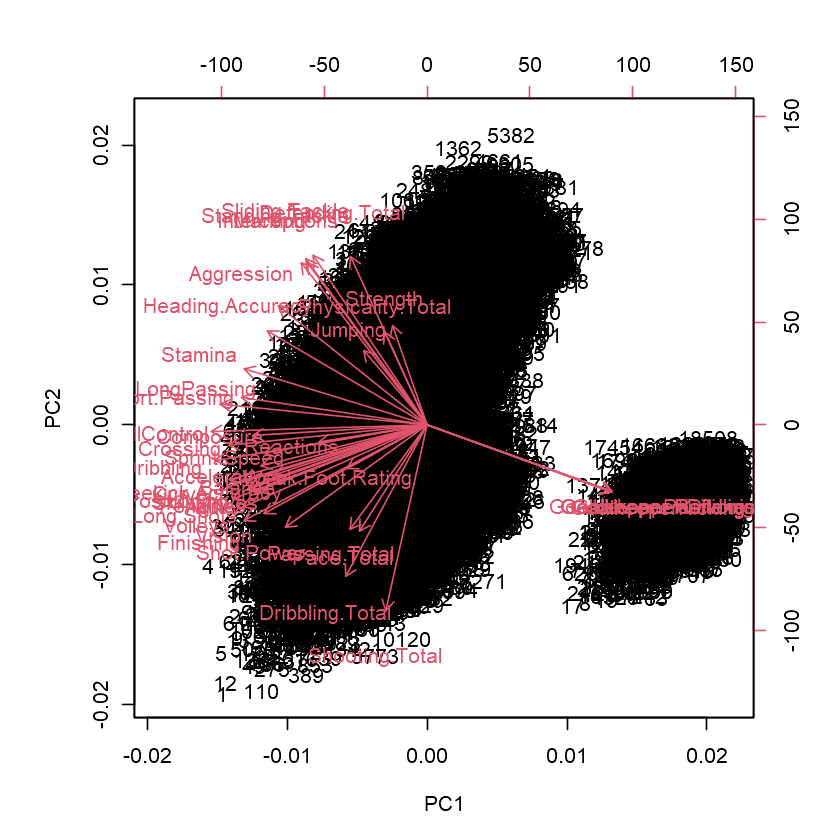

In [23]:
#options(repr.plot.width = 15, repr.plot.height =15)
biplot(pca)

- From the biplot graph we can make few interesting observations:
    - on the right hand corner we can see that the goalkeepers are clustered together
    - The other main cluster we can observe as well is on the left, which represents the field players
- Looking at the loading vectors we can also notice the following:
    - on the top left corner we can see the following attributes: sliding tackle, defending total, standing tackle, interceptions, marking, aggression, strength... All of these attributes mainly describe defenders, hence we can infer that the top part of the left cluster is mostly composed of defenders
    - As we go down the left clusters, we can also determine that the players become classified as more offensive, based on the following attributes we can see on the bottom left corner: finishing, shooting total, passing total, pace total, vision, long shots, dribbling...

An interesting way to confirm what we've just observed is to plot the PCA according to the players positions

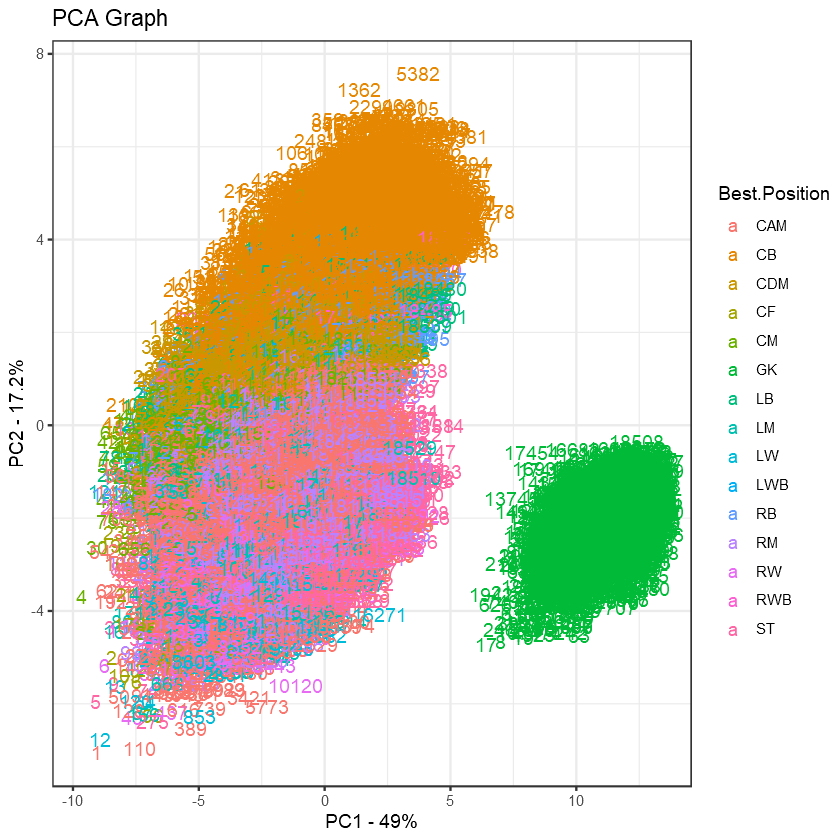

In [24]:
FPA$pc1 <- pca$x[,1]
FPA$pc2 <- pca$x[,2]
FPA$pc3 <- pca$x[,3]
ggplot(data = FPA, aes(x = pc1, y = pc2, color = Best.Position, label = rownames(pca$x)))+
geom_text()+
xlab(paste("PC1 - ", pca.var.per[1], "%", sep = ""))+
ylab(paste("PC2 - ", pca.var.per[2], "%", sep = ""))+
theme_bw()+
ggtitle("PCA Graph")

- Again, we can clearly see that the goalkeepers are grouped in one cluster while in the other cluster, the top part is mainly formed with defenders and the bottom part is mainly attackers.
- What can also be interesting to note is that we have wingbacks all over the cluster, which makes sense because in football usually there would be wingbacks who are more offensive and other wingbacks are more defensive. How a player is categorized as offensive or defensive is based on how they play in real life, so the style of play could be influenced by several factors, such as formation, league... It would be interesting to retrieve a dataset where we can identify which leagues for example have the most players who prefer to play an offensive style of play, but that's an analysis to be conducted some other time.

A final interesting 3D visualization of our PCA plot, showing PC1, PC2 and PC3 to get a better idea of the variation in the dataset.

In [25]:
fig <- plot_ly(FPA, x = ~pc1, y = ~pc2, z = ~pc3, color = ~Best.Position)
fig <- fig %>% add_markers()
fig <- fig %>% layout(scene = list(xaxis = list(title = 'PC1'),
                     yaxis = list(title = 'PC2'),
                     zaxis = list(title = 'PC3')))
fig

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
"


HTML widgets cannot be represented in plain text (need html)

## <span style="color: IndianRed;"> 3. Clustering: </span>

### <span style="color: LightSalmon;"> *3.1 K-means Clustering:* </span>

- Based on our general observation from running the PCA algorithm, we observe that the players are seperated into two groups: players(attackers, midfielders and defenders) and goalkeepers, and the players are seperated into two main parts, offensive and defensive players. Let's try and apply the k-means clustering at first using this observation to our advantage.
- However as we've decided, the optimal number of dimensions we selected after running the PCA algorithm is 3, we will come to that later...

In [26]:
set.seed(123)
#calculating distances between players where the number of clusters is 3, using the principal component scores we have where the number of dimensions is 2.
kc <- kmeans(pca$x[,1:2], centers = 3)
#number of datapoints in each cluster
table(kc$cluster)


    1     2     3 
10004  6474  2061 

- As we can see right away, the distribution of data points between the clusters is not even, so that might be an indicator telling us that we might need to change the number of our clusters. However let's see where will this lead us.

integer(0)

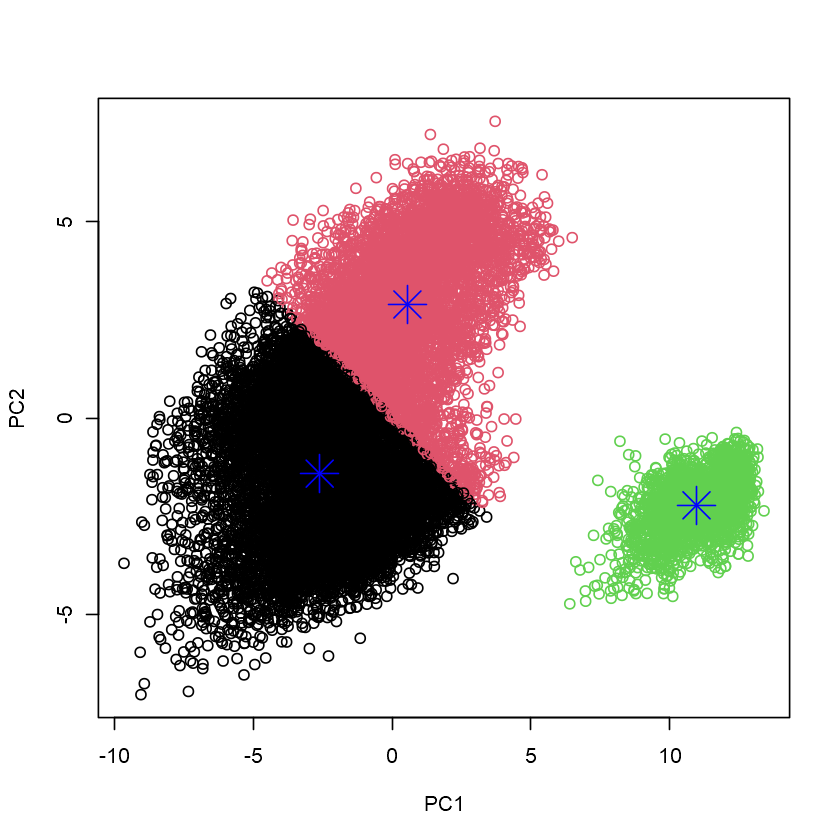

In [27]:
#Plotting the clusters with their centers
plot(pca$x[,1:2],col=factor(kc$cluster)) + points(kc$centers, pch = 8, cex = 3, col = "blue")

It seems that we were on the right path with our analysis, where we can see that the big cluster is divided into three subparts: offensive(black), defensive(red) and goalkeepers(green) 

What we just did is select the number of clusters (k) based on our intuition. However the question is, how can we make this more accurate? i.e how to choose the best number of clusters?
- one way we can do that is to minimize the total within-cluster variation.
    - Within-cluster variation for a single cluster can simply be defined as the sum of squares from the cluster mean, which in this case is the centroid we defined in the k-means algorithm. 
    - The total within-cluster variation is then the sum of within-cluster variations for each cluster.
- Using an Elbow plot we can determine which is the best number of clusters that we think we will be satisfied with

In [28]:
k.max <- 15
data <- pca$x[,1:2]
wss <- sapply(1:k.max, 
              function(k){
               kmeans(data, k, nstart=50,iter.max = 100 )$tot.withinss
               #if (kc$ifault==4) { stop("Failed in Quick-Transfer"); }
})
df.wss <- data.frame(wss)
df.wss

Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"


wss
<dbl>
515223.41
224685.31
112342.36
82940.74
58879.42
47869.10
41057.52
36006.31
32737.52


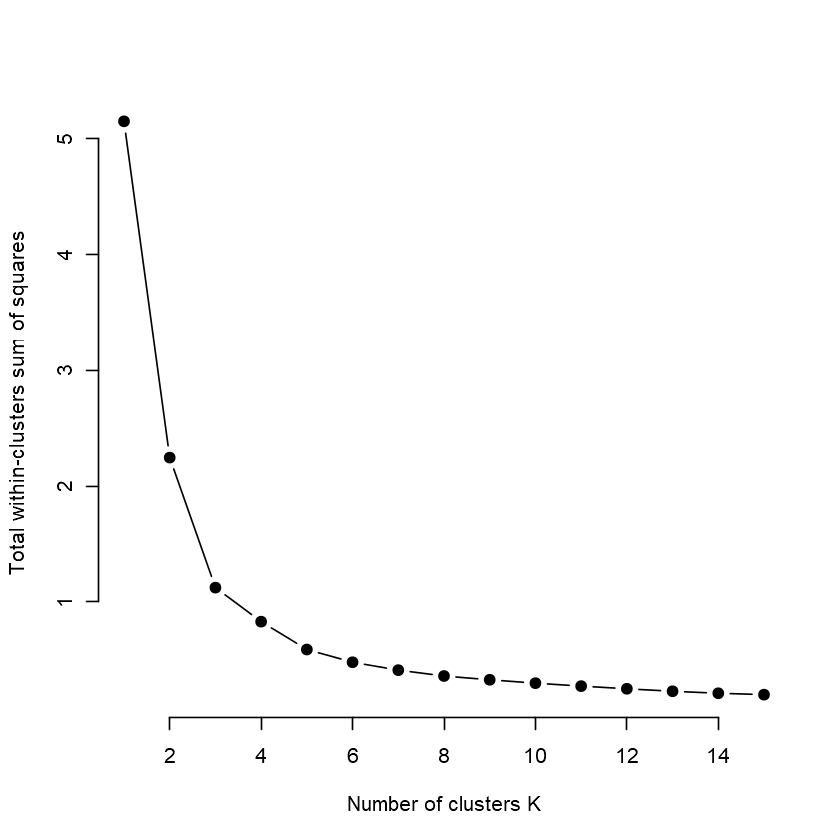

In [29]:
plot(1:k.max, wss/1e+05,
     type="b", pch = 19, frame = FALSE, 
     xlab="Number of clusters K",
     ylab="Total within-clusters sum of squares")

- Looking at both the elbow plot & the total within-cluster variation scores, It seems like the Total_ss tends to change slowly starting from k = 6

In [30]:
set.seed(123)
kc <- kmeans(pca$x[,1:2], centers = 6)
#number of datapoints in each cluster
table(kc$cluster)


   1    2    3    4    5    6 
3339 3937 2061 2918 2847 3437 

It seems like now we have a some-what average number of datapoints in each cluster.

integer(0)

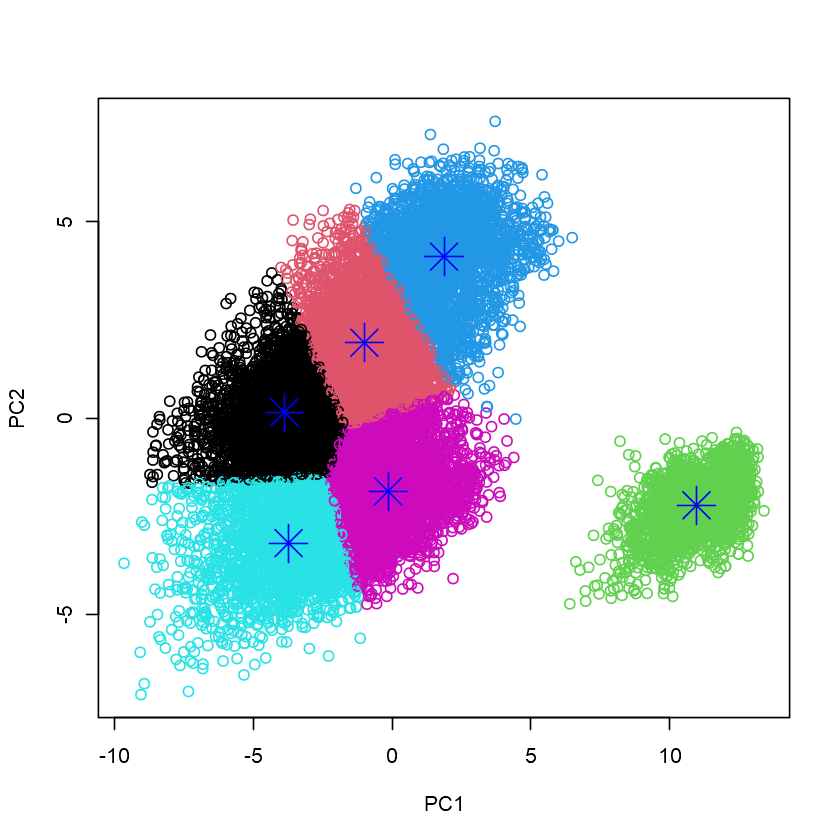

In [31]:
#Plotting the clusters with their centers
plot(pca$x[,1:2],col=factor(kc$cluster)) + points(kc$centers, pch = 8, cex = 3, col = "blue")

- Seeing how the clusters are formed, we can clearly see the goalkeepers are identified as a one cluster and for the others, they represent how players are less defensive and more offensive gradually. For instance, the very top cluster seems to be representing the defenders, and as we go down, the defensive attributes of the players decrease gradually while the offensive attributes increase gradually as well. 

- Now let's apply the same thought process we just did, but using the optimal number of dimensions (3).

In [32]:
set.seed(123)
#calculating distances between players where the number of clusters is 3, using the principal component scores we have where the optimal number of dimensions is 3.
kc.3d <- kmeans(pca$x[,1:3], centers = 3)
#number of datapoints in each cluster
table(kc.3d$cluster)


   1    2    3 
9655 6823 2061 

Again, it seems like there's an imbalance between the distribution of the datapoints in the clusters, but as we did before, let's see where this will lead us.

In [33]:
df <- data.frame(pca$x)
head(df$PC1)

[1] -9.058479 -8.461731 -8.549457 -9.669586 -9.085980 -8.733202

In [34]:
fig <- plot_ly(df, x = ~PC1, y = ~PC2, z = ~PC3, color =kc.3d$cluster)
fig <- fig %>% add_markers()
fig <- fig %>% layout(scene = list(xaxis = list(title = 'PC1'),
                     yaxis = list(title = 'PC2'),
                     zaxis = list(title = 'PC3')))
fig

HTML widgets cannot be represented in plain text (need html)

- Same observation we achieved when using 2 dimensions.

- let's find the optimal number of clusters using the total within-cluster varation and the elbow plot

In [35]:
k.max <- 15
data <- pca$x[,1:3]
wss <- sapply(1:k.max, 
              function(k){
               kmeans(data, k, nstart=50,iter.max = 100 )$tot.withinss
               #if (kc$ifault==4) { stop("Failed in Quick-Transfer"); }
})
df.wss <- data.frame(wss)
df.wss

Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage steps exceeded maximum (= 926950)"
Warning message:
"Quick-TRANSfer stage

wss
<dbl>
593573.70
291672.49
177417.20
122928.05
98027.75
82648.21
73235.80
65144.95
58534.96


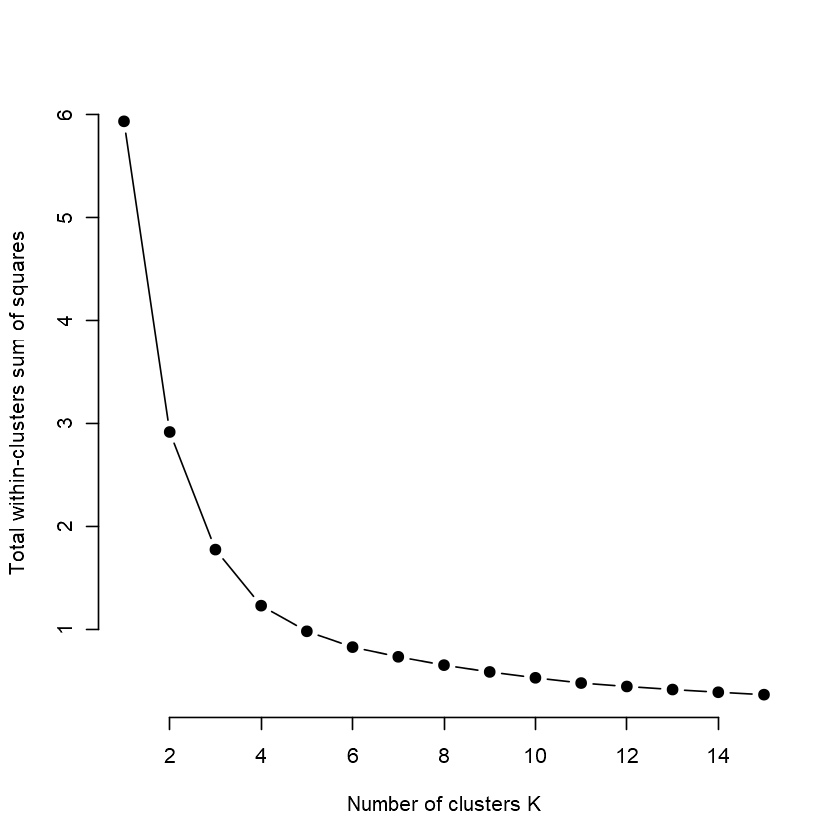

In [36]:
plot(1:k.max, wss/1e+05,
     type="b", pch = 19, frame = FALSE, 
     xlab="Number of clusters K",
     ylab="Total within-clusters sum of squares")

- Looking at both the elbow plot & the total within-cluster variation scores, and again it seems like the Total_ss tends to change slowly starting from k = 6

In [37]:
set.seed(123)
#calculating distances between players where the optimal number of clusters is 4, using the principal component scores we have where the optimal number of dimensions is 3.
kc.3d <- kmeans(pca$x[,1:3], centers = 6)
#number of datapoints in each cluster
table(kc.3d$cluster)


   1    2    3    4    5    6 
2512 4375 2061 3135 3439 3017 

- We can observe that we have again a some-what average number of datapoints in each cluster.

In [38]:
fig <- plot_ly(df, x = ~PC1, y = ~PC2, z = ~PC3, color =kc.3d$cluster)
fig <- fig %>% add_markers()
fig <- fig %>% layout(scene = list(xaxis = list(title = 'PC1'),
                     yaxis = list(title = 'PC2'),
                     zaxis = list(title = 'PC3')))
fig

HTML widgets cannot be represented in plain text (need html)

- Let's use another clustering method but without pre-specifying the number of cluster and later we can compare results.

### <span style="color: LightSalmon;"> *3.2 Hierarchical Clustering:* </span>

- We're going to use the PCA scores to our advantage, where we have been able to reduce the dimensionality of our dataset to just 3 dimensions.

In [39]:
scores <- data.frame(pca$x)

In [40]:
head(scores[,1:2])

,PC1,PC2
,<dbl>,<dbl>
1,-9.058479,-7.048247
2,-8.461731,-5.005057
3,-8.549457,-4.359609
4,-9.669586,-3.700620
5,-9.085980,-5.968851
6,-8.733202,-5.192656


- First let's apply the hierarchical clustering using only two dimensions to have a general idea on how the dataset will be clustered

In [41]:
dm <- dist(scores[,1:2])

In [42]:
hc<-hclust(dm, method="complete")

In [43]:
## agglomeration program function
agglo <- function(hc){
  data.frame(row.names=paste0("Cluster",seq_along(hc$height)),
             height=hc$height,
             components=ifelse(hc$merge<0, 
                               hc$labels[abs(hc$merge)], paste0("Cluster",hc$merge)),
             stringsAsFactors=FALSE) }
head(agglo(hc))

,height,components.1,components.2
,<dbl>,<chr>,<chr>
Cluster1,0,1413,1470
Cluster2,0,1414,1482
Cluster3,0,1415,1516
Cluster4,0,1416,1703
Cluster5,0,1417,1638
Cluster6,0,1418,1514


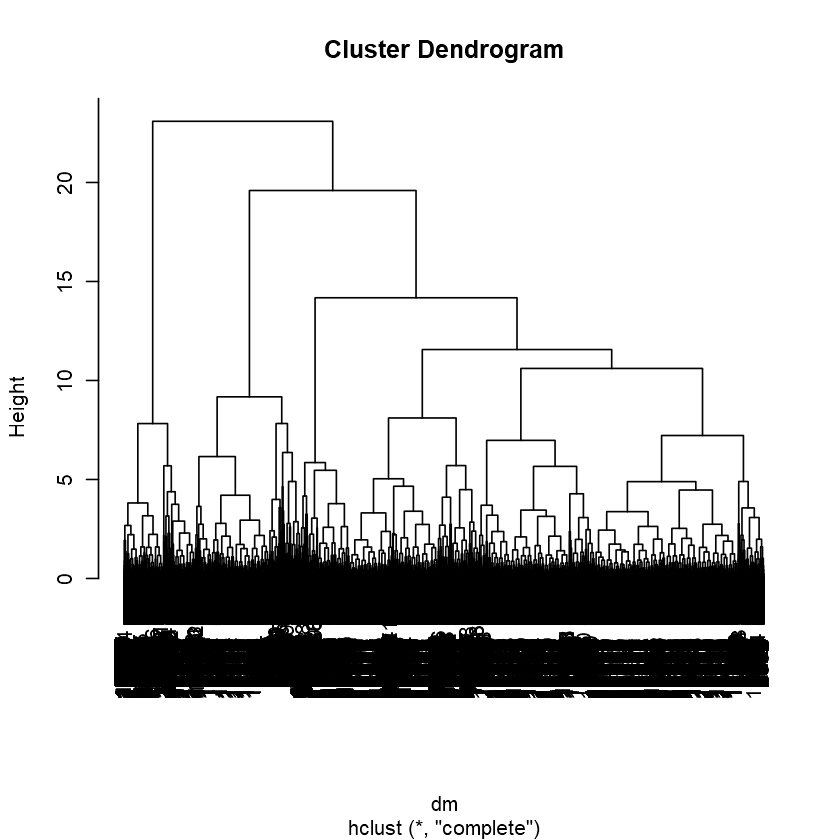

In [44]:
plot(hc)

- Seems like we're already off to a good start, as we can observe from the dendrogram that there are 6 main clusters (same as what we found out using k-means clustering).

In [45]:
hc<-color_branches(hc, k=6)

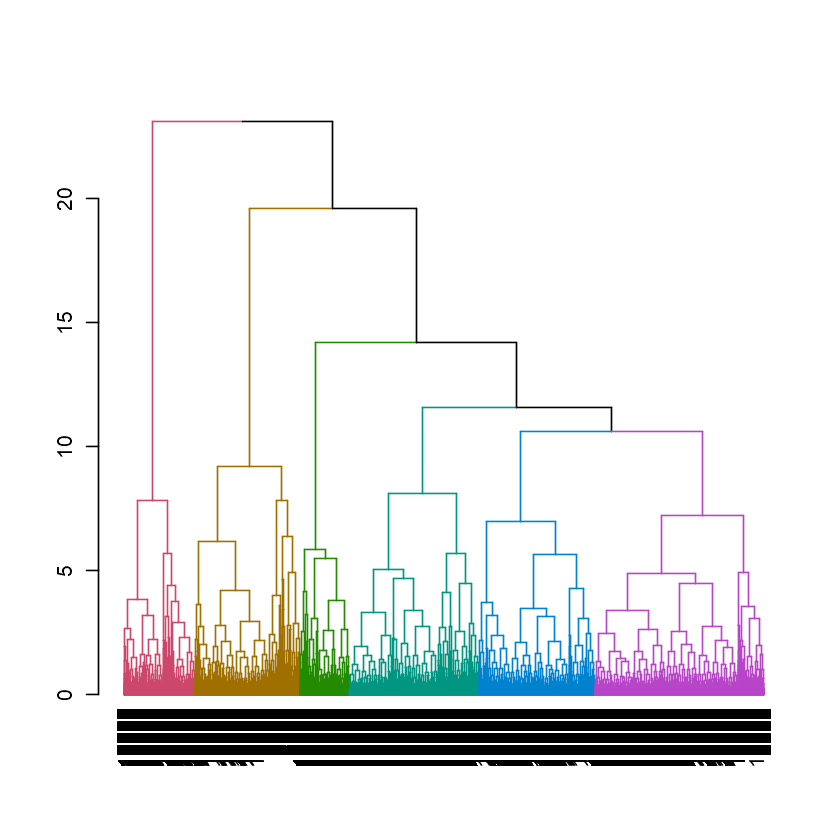

In [46]:
plot(hc)

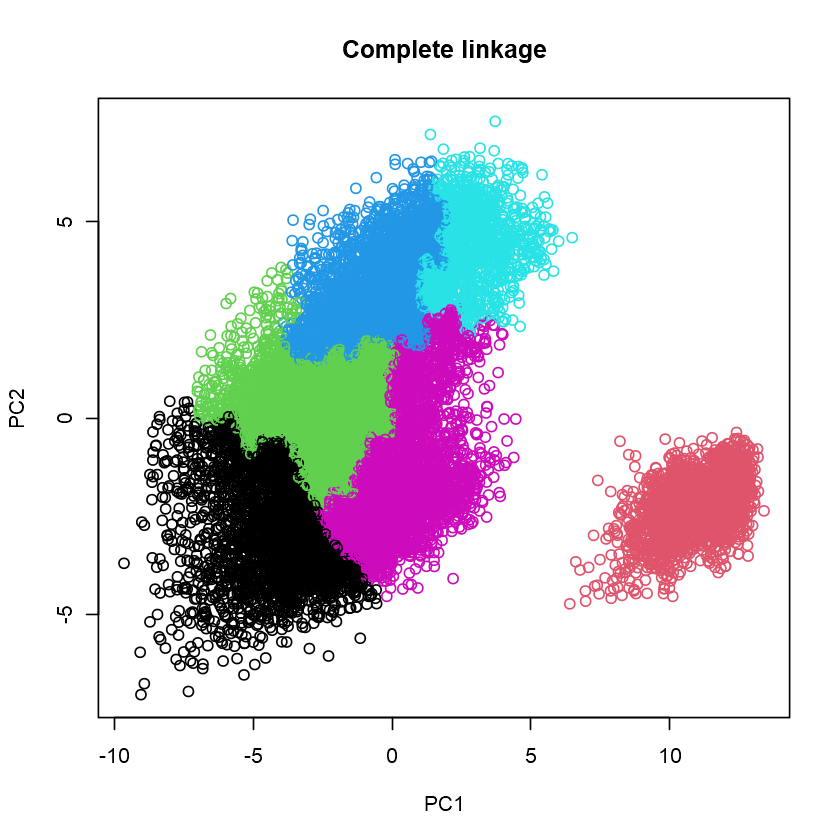

In [47]:
clu <- cutree(hc, k=6)
plot(scores[,1:2], col=clu, main="Complete linkage")

- Same observation we had when using k-means clustering. Now let's shift to using 3 dimensions and see how are our data points (players) clustered.

In [48]:
dm.3d <- dist(scores[,1:3])

In [49]:
hc.3d<-hclust(dm.3d, method="complete")

In [50]:
## agglomeration program function
agglo <- function(hc){
  data.frame(row.names=paste0("Cluster",seq_along(hc$height)),
             height=hc$height,
             components=ifelse(hc$merge<0, 
                               hc$labels[abs(hc$merge)], paste0("Cluster",hc$merge)),
             stringsAsFactors=FALSE) }
head(agglo(hc.3d))

,height,components.1,components.2
,<dbl>,<chr>,<chr>
Cluster1,0,1413,1470
Cluster2,0,1414,1482
Cluster3,0,1415,1516
Cluster4,0,1416,1703
Cluster5,0,1417,1638
Cluster6,0,1418,1514


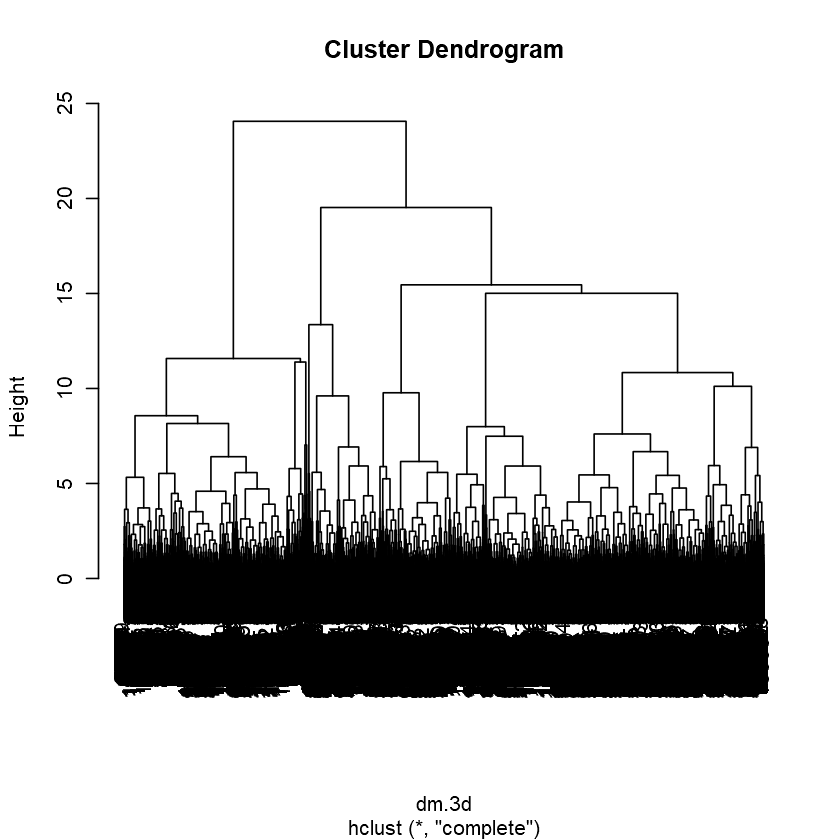

In [51]:
plot(hc.3d)

- Again it looks like the main clusters in our dendrogram are 6. 

In [52]:
hc.3d<-color_branches(hc, k=6)

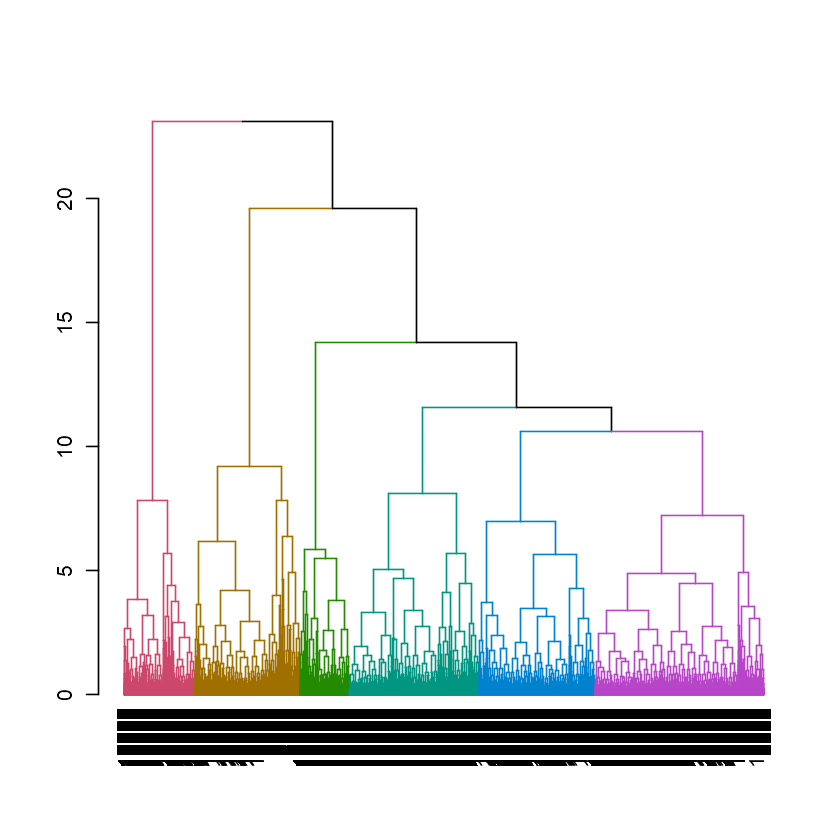

In [53]:
plot(hc.3d)

In [54]:
clu <- cutree(hc.3d, k=6)

In [55]:
fig <- plot_ly(scores, x = ~PC1, y = ~PC2, z = ~PC3, color =clu)
fig <- fig %>% add_markers()
fig <- fig %>% layout(scene = list(xaxis = list(title = 'PC1'),
                     yaxis = list(title = 'PC2'),
                     zaxis = list(title = 'PC3')))
fig

HTML widgets cannot be represented in plain text (need html)

- We can distinguish that using k-means clustering and Hierchical clustering we end up with somewhat the same conclusion, which is, our datapoints are best divided into 6 main clusters. Where the first one is the goalkeepers and the other 5 clusters represent the rest of the players. Each cluster represent a set of players with certain attributes as their strong features. For example some players have higher scores in their defensive attributes than others, which means they're more suited in playing a more defensive playstyle, example defenders or defensive midfielders. While others are more suited in playing a more offensive playstyle... However looking at the biplot we drew earlier in the PCA section, we can actually observe that being offensive or defensive player is a very general/broad observation. There are other measurements that describe the player's style of play, for example how creative is s/he, how versatile is s/he, how clinical is s/he. All of these measurements/metrics explain to us the meaning behind how the players are being clustered using both of the techniques we talked about earlier.